# gpt-image-1 on Azure AI Foundry - Image to Image Generation

<img src="https://azure.microsoft.com/en-us/blog/wp-content/uploads/2025/04/Azure-AI-ML-Scene-3.png" width=300>



In [1]:
import base64
import datetime
import os
import re
import requests
import sys
import time

from dotenv import load_dotenv
from io import BytesIO
from openai import AzureOpenAI
from PIL import Image

In [2]:
sys.version

'3.13.9 (main, Oct 14 2025, 13:52:31) [Clang 17.0.0 (clang-1700.0.13.3)]'

In [3]:
datetime.datetime.today().strftime('%d %b %Y %H:%M:%S')

'10 Nov 2025 13:39:35'

In [4]:
load_dotenv("azure.env")

api_version = "2025-04-01-preview"

In [5]:
model = "gpt-image-1"

In [6]:
IMAGES_DIR = "images"

In [7]:
RESULTS_DIR = "image_to_image_results"

os.makedirs(RESULTS_DIR, exist_ok=True)

## 1. Image-to-Image Transformation Function

This function takes an input image and transforms it based on a text prompt. Unlike simple editing which modifies specific elements, image-to-image generation can perform more holistic transformations like style transfers, mood changes, and complete reimagining while preserving the original composition.

In [8]:
def image_to_image(image_file, prompt, n=1, size="1024x1024", quality="high"):
    """
    Transforms an input image based on a text prompt using Azure OpenAI's image editing endpoint.
    
    This function enables image-to-image transformations such as:
    - Style transfers (photo to painting, realistic to cartoon, etc.)
    - Mood and atmosphere changes (day to night, sunny to rainy)
    - Artistic effects and filters
    - Seasonal transformations
    - Complete reimagining while preserving composition

    Parameters:
        image_file (str): Path to the source image file.
        prompt (str): Text description guiding the image transformation.
        n (int, optional): Number of transformed images to generate. Defaults to 1.
        size (str, optional): Output image size. Options: "1024x1024", "1536x1024", "1024x1536". Defaults to "1024x1024".
        quality (str, optional): Image quality. Options: "high", "medium", "low". Defaults to "high".

    Returns:
        list[str] or None: A list of file paths to the saved transformed images if successful,
                           or None if an error occurs during the process.

    The function:
        - Sends the input image and transformation prompt to Azure OpenAI's image edits endpoint.
        - Decodes the base64 image data returned in the response.
        - Saves the resulting images to a results directory.
        - Returns the list of file paths to the saved images.
    """
    try:
        # Headers
        headers = {"api-key": os.getenv("IMAGEGEN_AOAI_API_KEY")}
        
        # URL - Extract base endpoint and construct URL
        endpoint = os.getenv("IMAGEGEN_AOAI_RESOURCE")
        deployment = os.getenv("IMAGEGEN_DEPLOYMENT", model)
        # Remove trailing slash if present
        endpoint = endpoint.rstrip('/')
        url = f"{endpoint}/openai/deployments/{deployment}/images/edits?api-version={api_version}"
        
        # Files
        files = {"image": open(image_file, "rb")}
        
        # Data
        data = {
            "prompt": prompt,
            "n": n,
            "size": size,
            "quality": quality,
        }

        # Send the request
        response = requests.post(url, headers=headers, files=files, data=data)
        response.raise_for_status()
        
        # Get the results
        images_data = response.json()["data"]
        encoded_images = [img["b64_json"] for img in images_data]

        # Parse and save the generated images
        output_images_list = []

        for encoded_image in encoded_images:
            img = Image.open(BytesIO(base64.b64decode(encoded_image)))
            
            # Save image to file
            fname = os.path.splitext(os.path.basename(image_file))[0]
            now = str(datetime.datetime.today().strftime("%Y%m%d_%H%M%S_%f")[:-3])
            output_file = os.path.join(RESULTS_DIR, f"{fname}_i2i_{now}.jpg")
            img.save(output_file)
            print(f"File saved: {output_file}")
            output_images_list.append(output_file)

    except Exception as e:
        print(f"Error generating images: {e}")
        return None

    return output_images_list

## 2. Style Transfer Examples

Transform images from one artistic style to another.

Original Image:


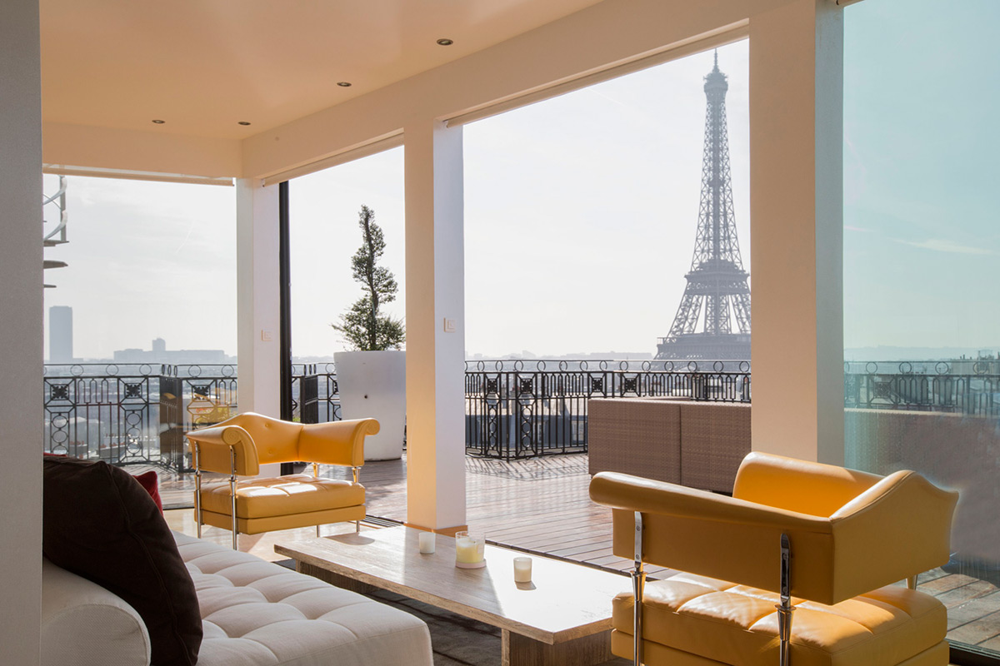

In [9]:
# Load a source image
image_file = os.path.join(IMAGES_DIR, "appartment.jpg")

print("Original Image:")
img = Image.open(image_file)
display(img)

### 2.1 Photo to Watercolor Painting

File saved: image_to_image_results/appartment_i2i_20251110_134033_563.jpg
File saved: image_to_image_results/appartment_i2i_20251110_134033_597.jpg


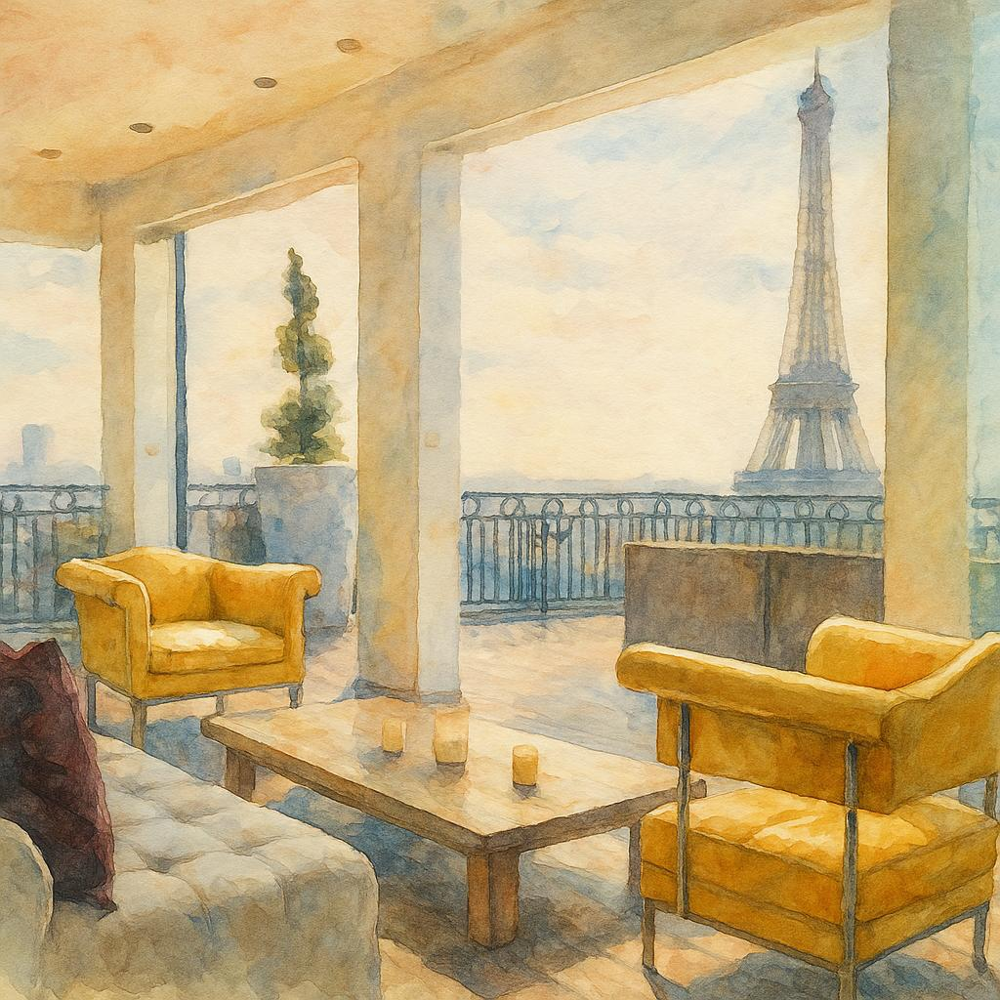

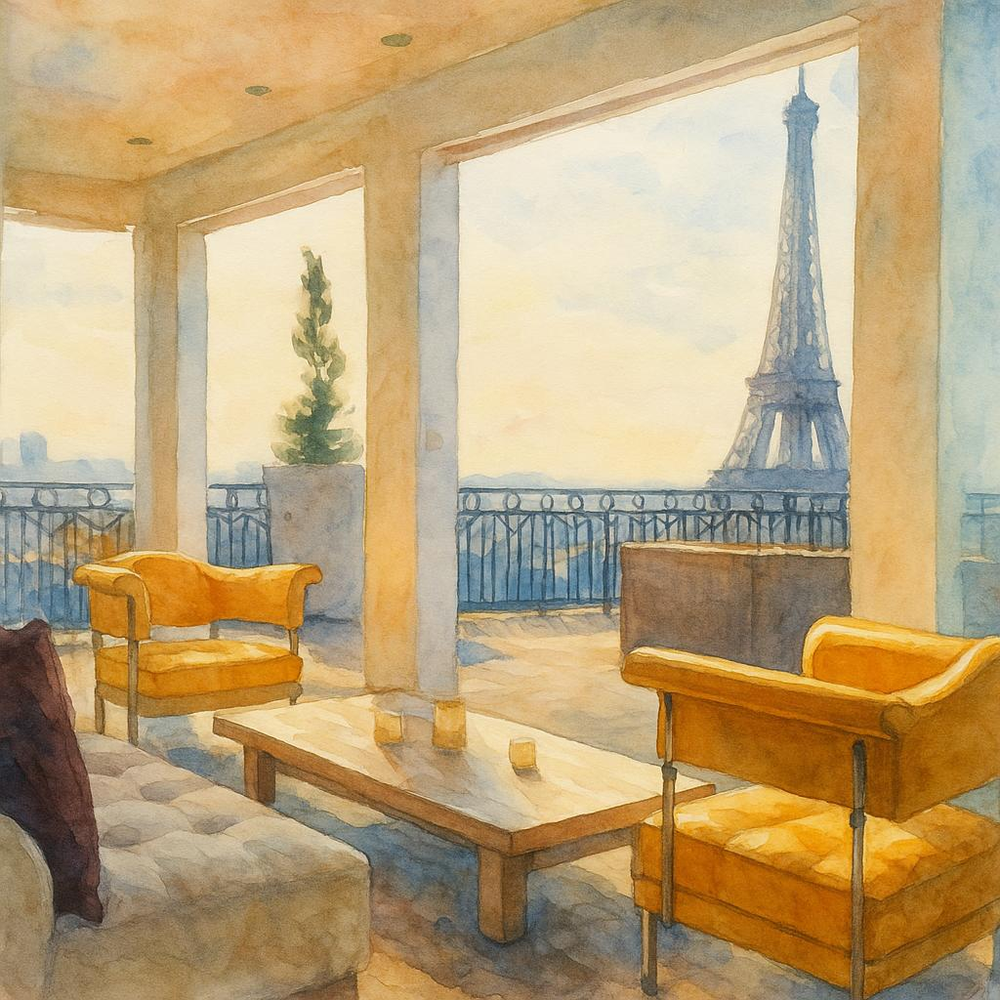

In [10]:
prompt = "Transform this image into a beautiful watercolor painting with soft colors and artistic brush strokes"

images_list = image_to_image(image_file, prompt, n=2)

for img_path in images_list:
    img = Image.open(img_path)
    display(img)

### 2.2 Photo to Oil Painting

File saved: image_to_image_results/appartment_i2i_20251110_134134_892.jpg
File saved: image_to_image_results/appartment_i2i_20251110_134134_922.jpg


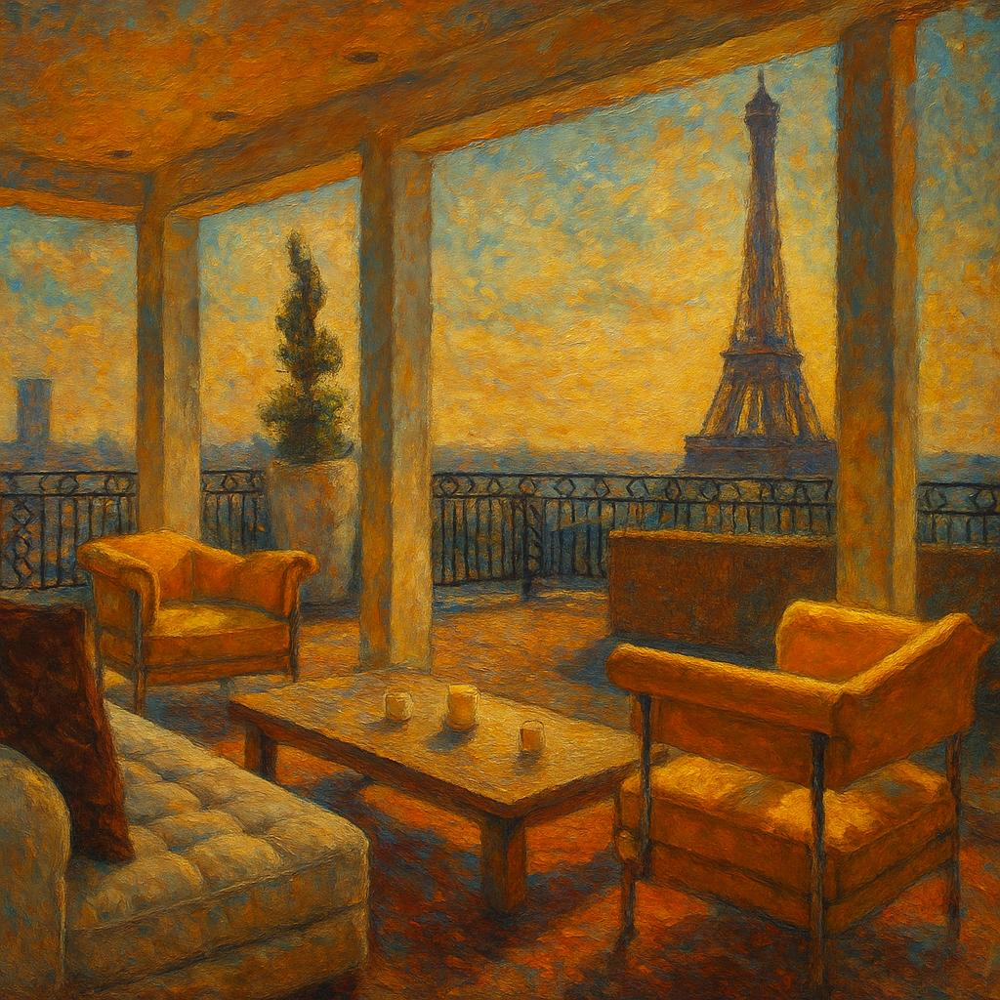

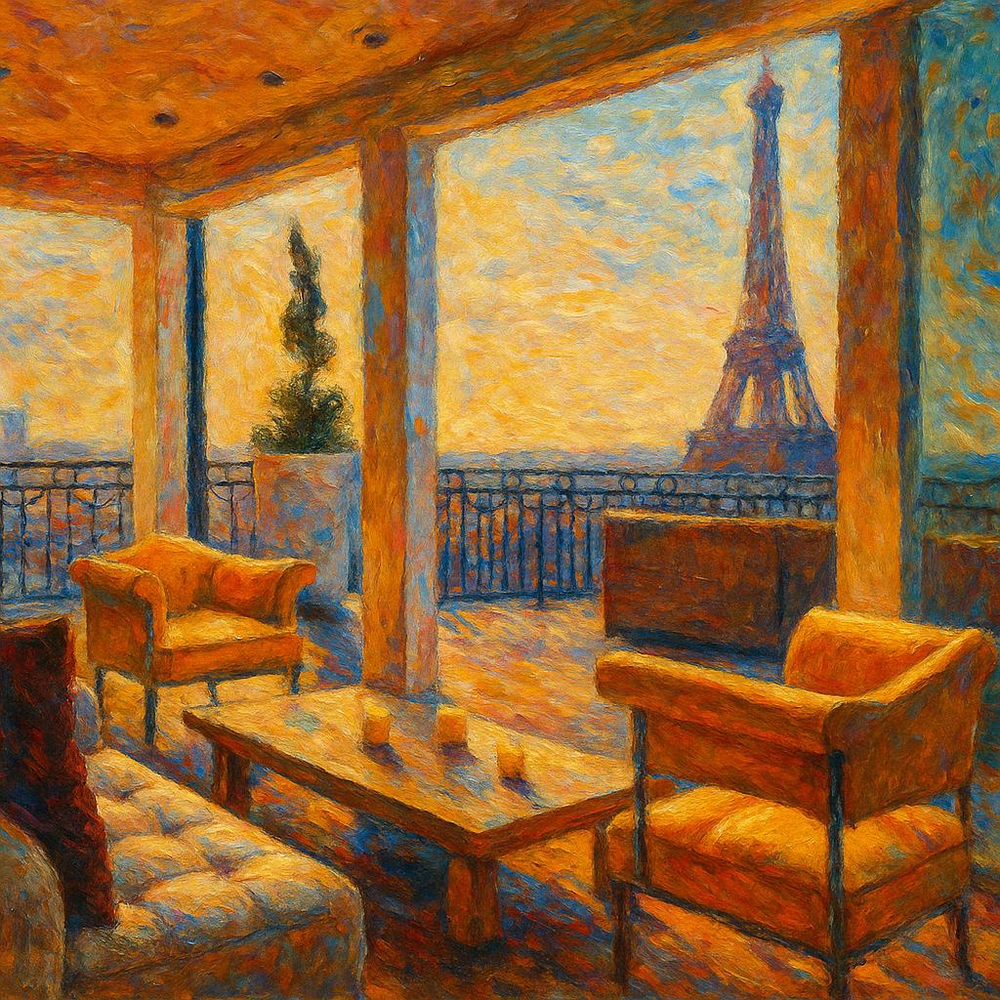

In [11]:
prompt = "Convert this scene into a classical oil painting with rich textures and vibrant colors, in the style of impressionist masters"

images_list = image_to_image(image_file, prompt, n=2)

for img_path in images_list:
    img = Image.open(img_path)
    display(img)

### 2.3 Photo to Anime/Cartoon Style

File saved: image_to_image_results/appartment_i2i_20251110_134243_211.jpg
File saved: image_to_image_results/appartment_i2i_20251110_134243_243.jpg


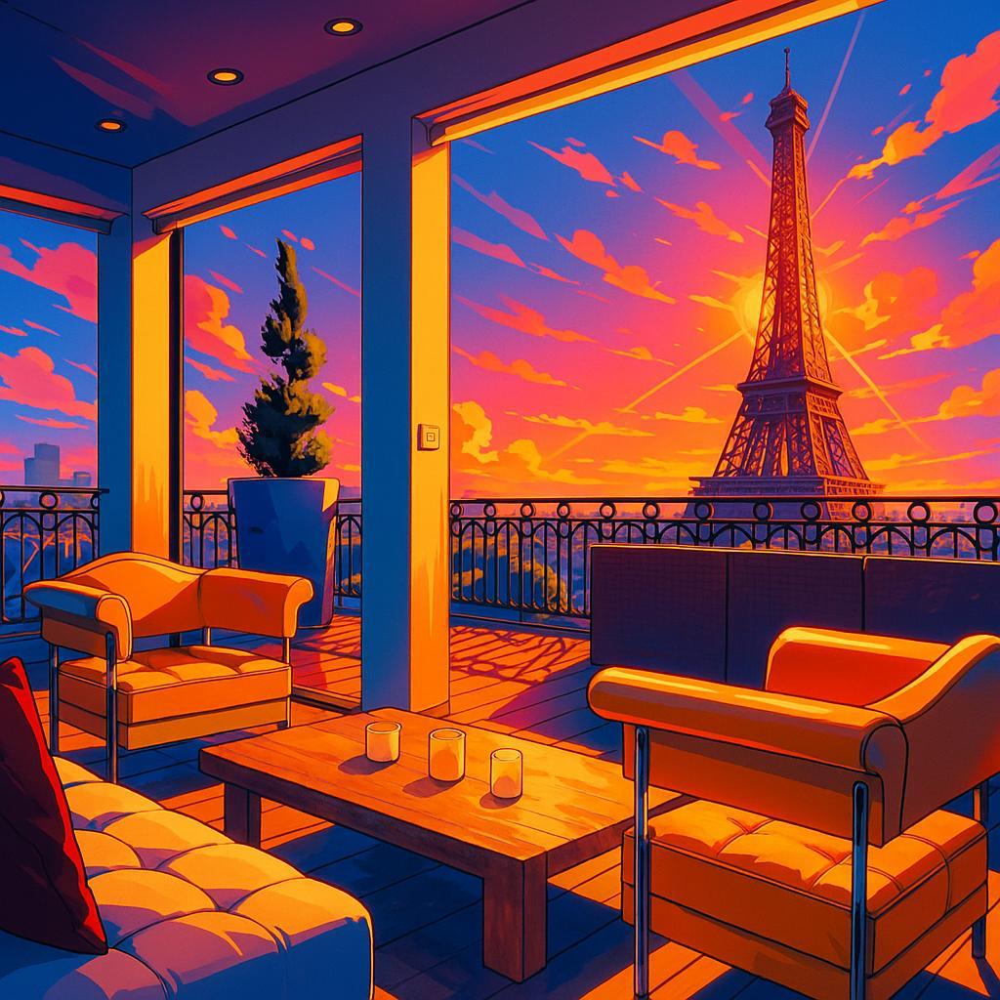

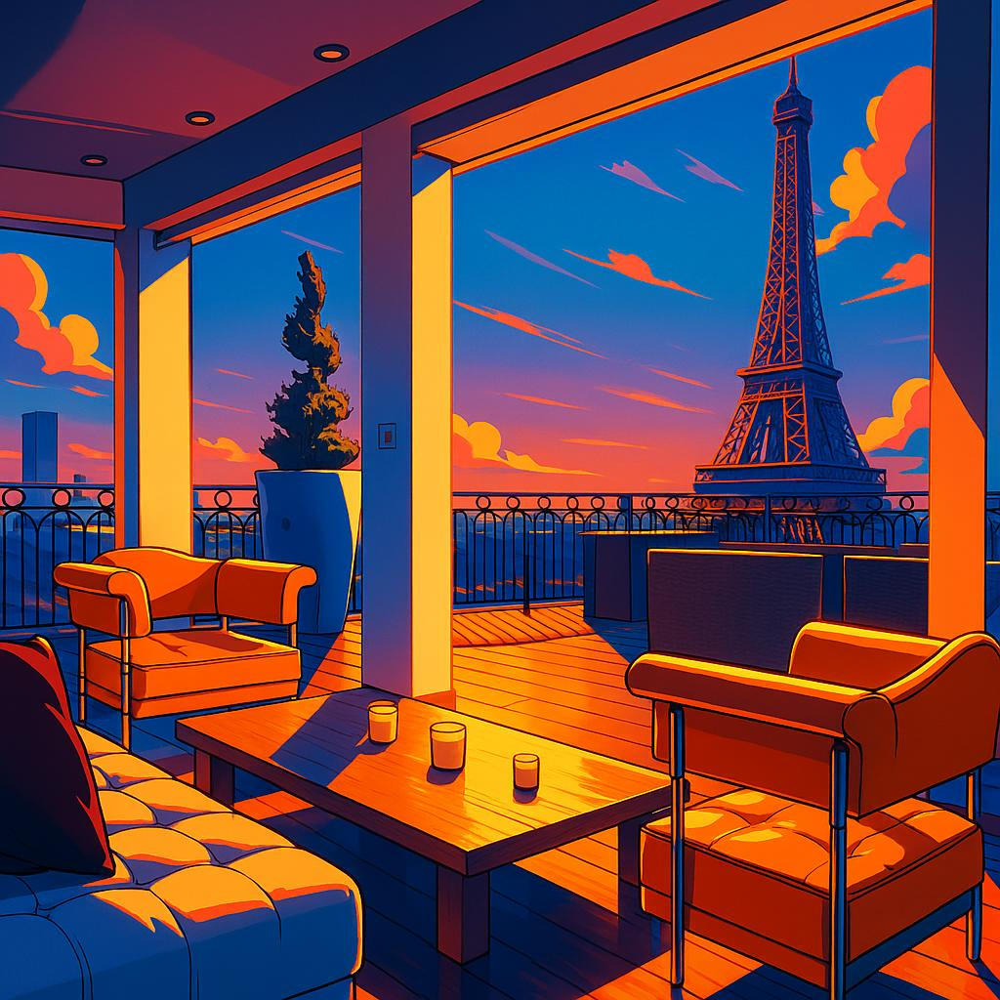

In [12]:
prompt = "Transform this photo into a vibrant anime-style illustration with bold colors, clean lines, and dramatic lighting"

images_list = image_to_image(image_file, prompt, n=2)

for img_path in images_list:
    img = Image.open(img_path)
    display(img)

## 3. Mood and Atmosphere Transformations

Change the mood, lighting, and atmosphere of an image.

### 3.1 Day to Night Transformation

File saved: image_to_image_results/appartment_i2i_20251110_134357_290.jpg
File saved: image_to_image_results/appartment_i2i_20251110_134357_325.jpg


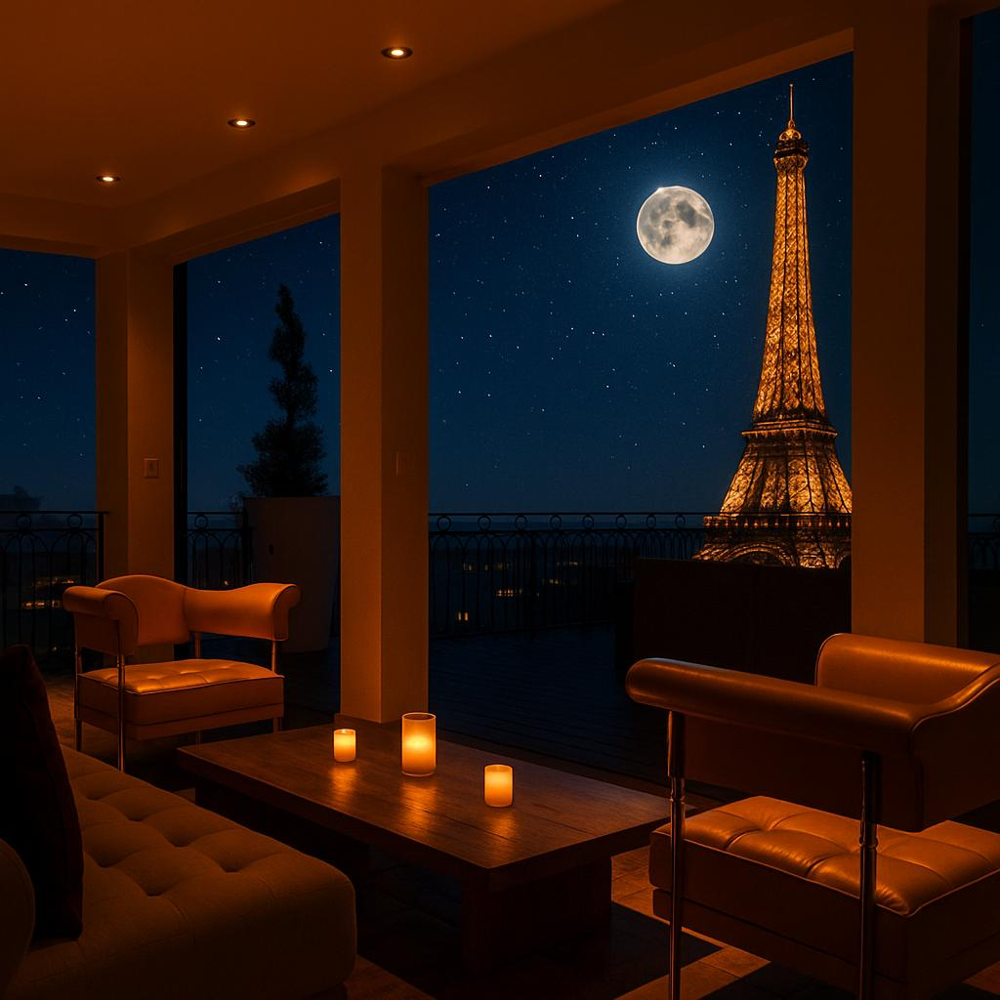

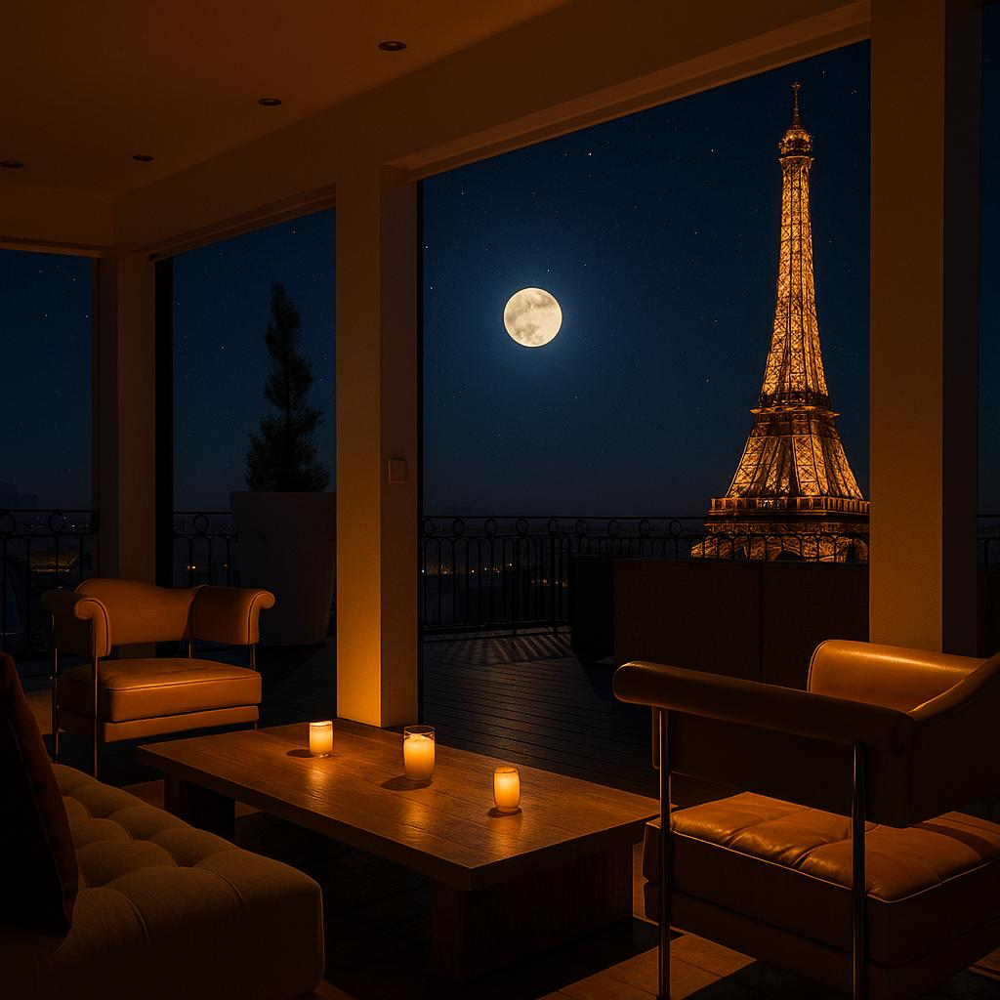

In [13]:
prompt = "Transform this daytime scene into a beautiful night scene with stars, moonlight, and warm interior lighting"

images_list = image_to_image(image_file, prompt, n=2)

for img_path in images_list:
    img = Image.open(img_path)
    display(img)

### 3.2 Sunny to Rainy/Stormy

File saved: image_to_image_results/appartment_i2i_20251110_134503_136.jpg
File saved: image_to_image_results/appartment_i2i_20251110_134503_170.jpg


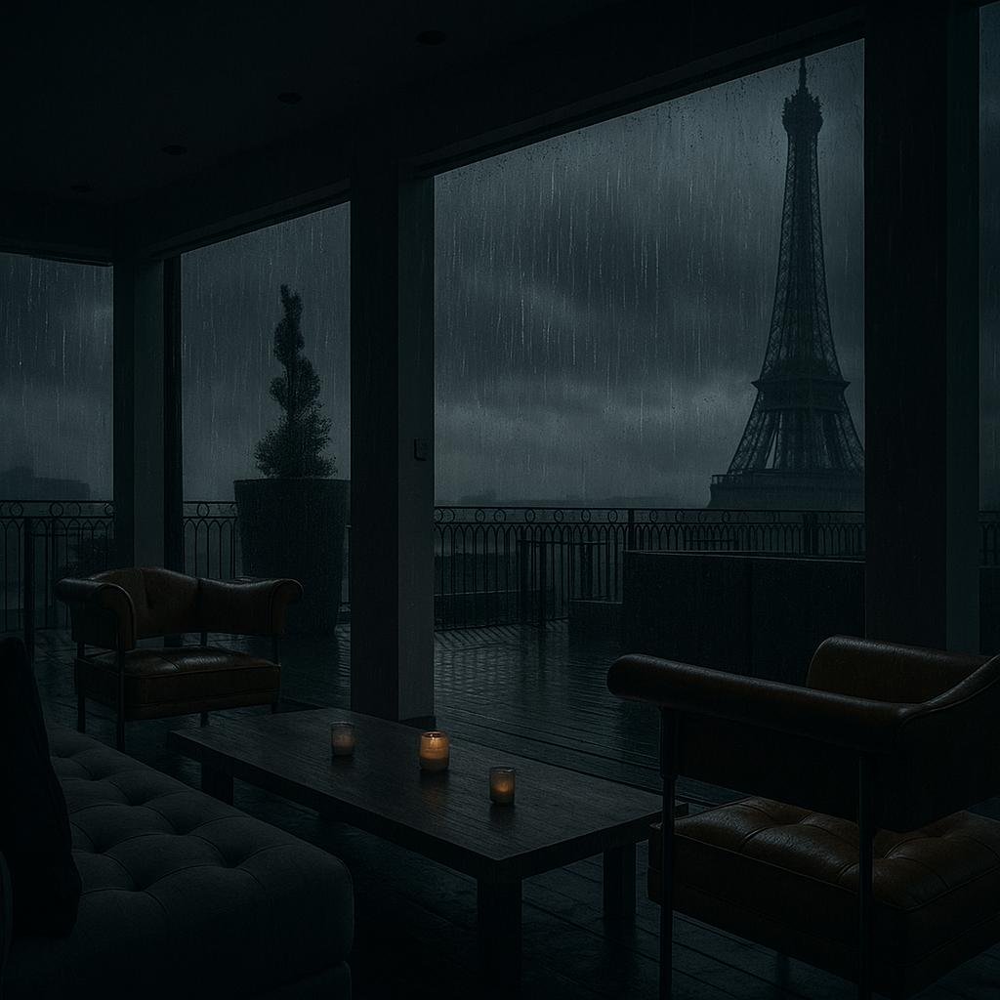

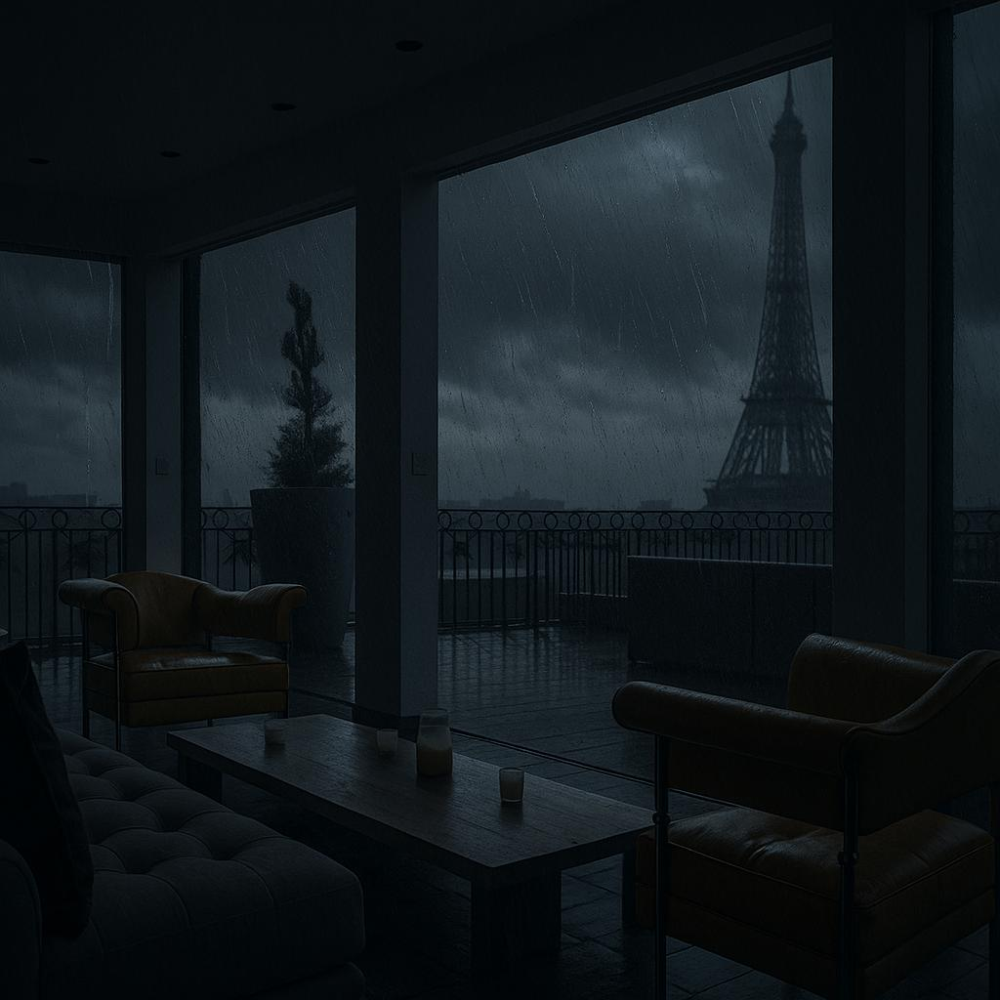

In [14]:
prompt = "Transform this scene into a dramatic rainy day with dark clouds, rain drops, and moody atmospheric lighting"

images_list = image_to_image(image_file, prompt, n=2)

for img_path in images_list:
    img = Image.open(img_path)
    display(img)

### 3.3 Golden Hour / Sunset Lighting

File saved: image_to_image_results/appartment_i2i_20251110_134601_135.jpg
File saved: image_to_image_results/appartment_i2i_20251110_134601_164.jpg


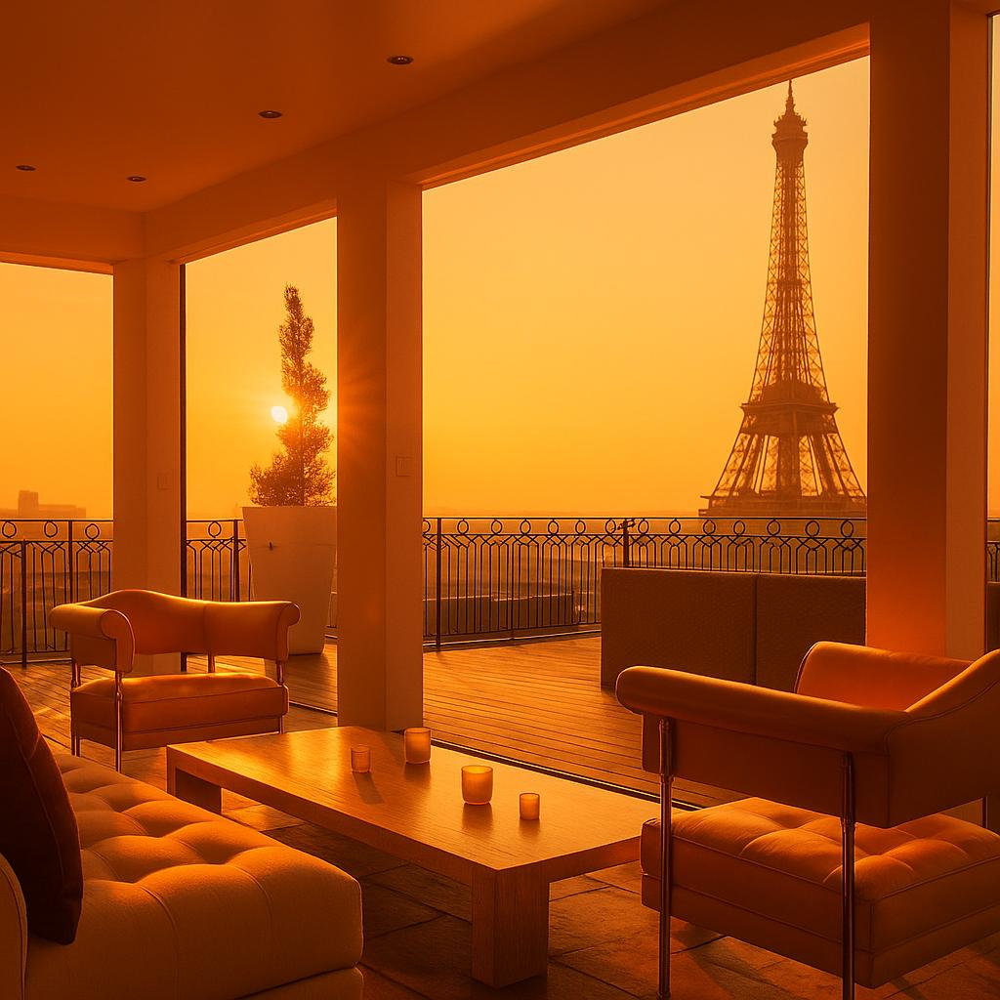

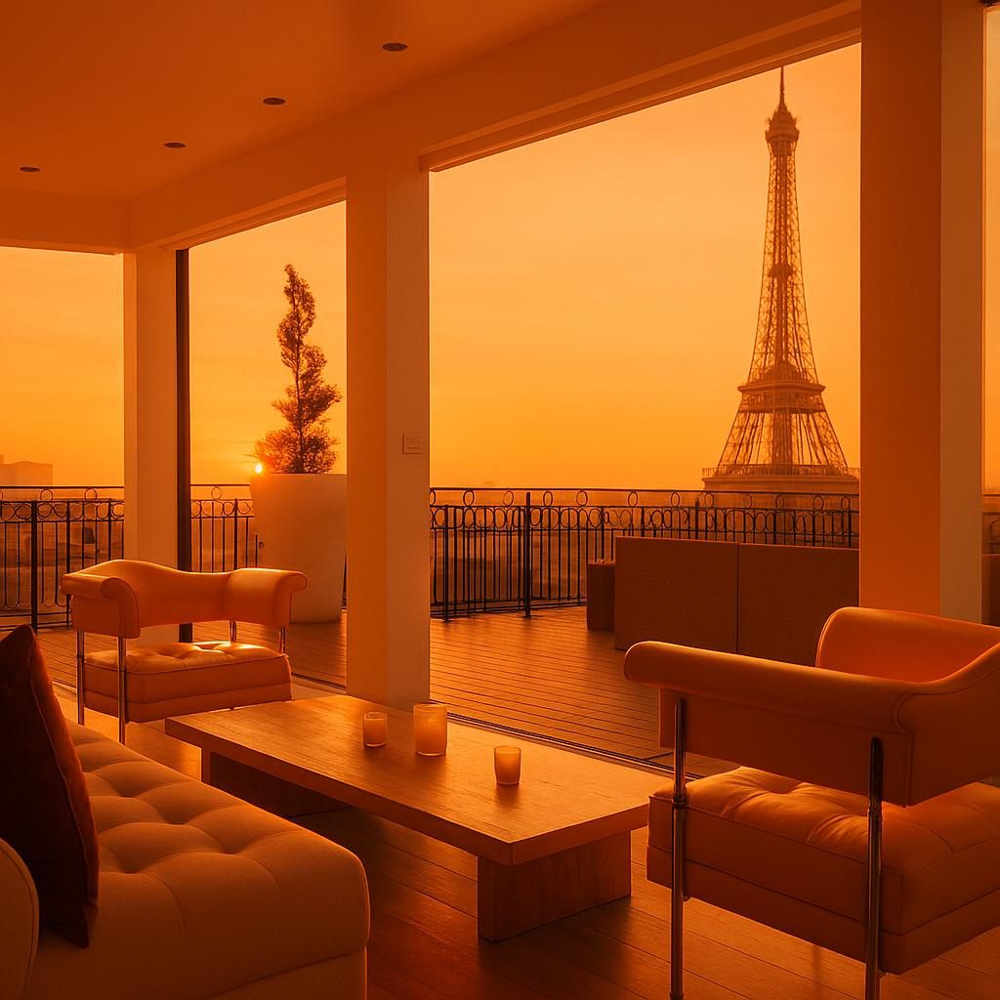

In [15]:
prompt = "Transform this image with beautiful golden hour lighting, warm sunset tones, and soft glowing atmosphere"

images_list = image_to_image(image_file, prompt, n=2)

for img_path in images_list:
    img = Image.open(img_path)
    display(img)

## 4. Seasonal Transformations

Transform images across different seasons.

### 4.1 Summer to Winter

File saved: image_to_image_results/appartment_i2i_20251110_134710_163.jpg
File saved: image_to_image_results/appartment_i2i_20251110_134710_198.jpg


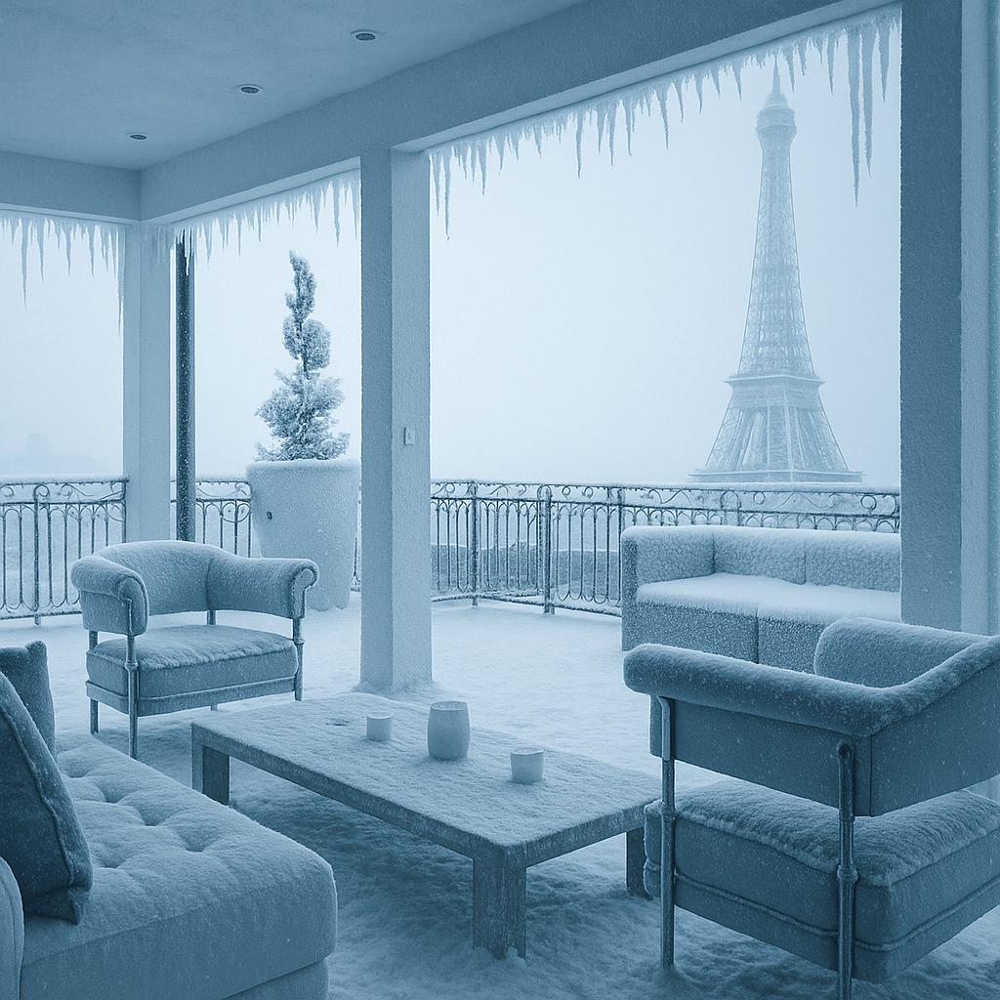

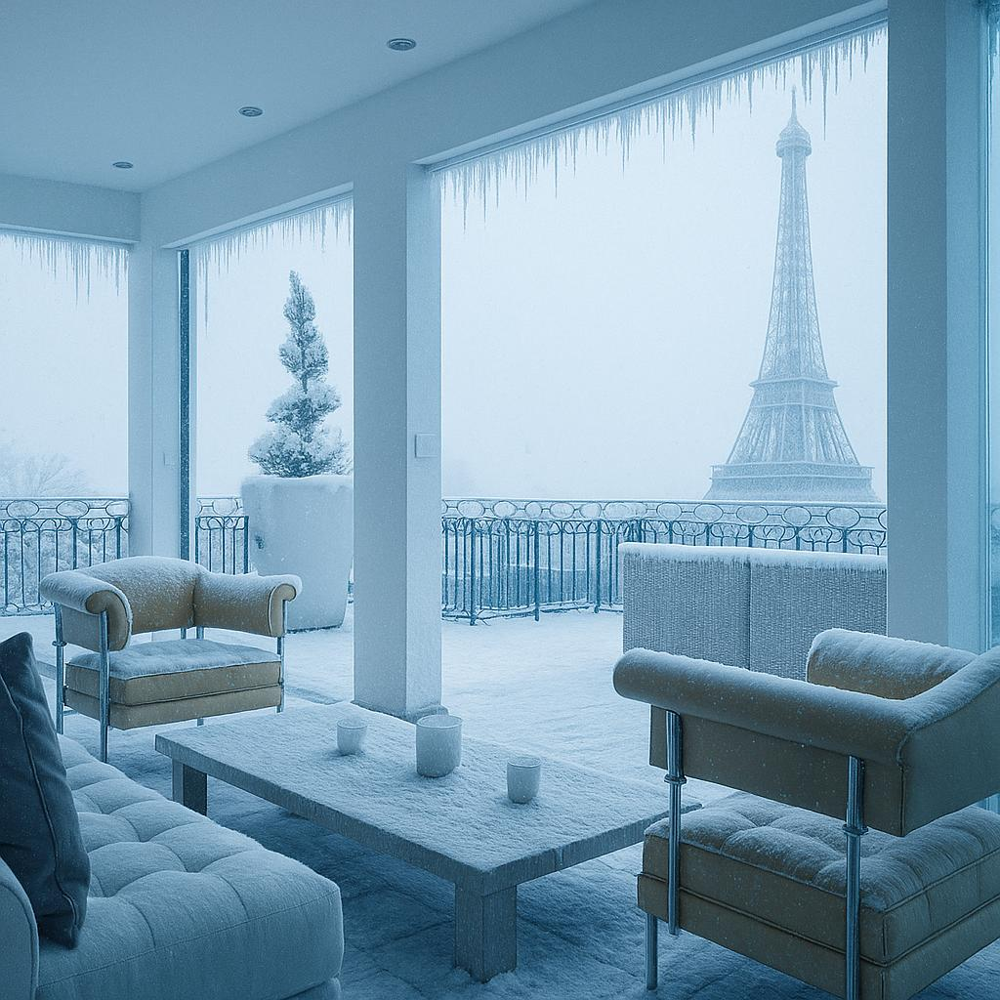

In [16]:
prompt = "Transform this scene into a winter wonderland with snow covering everything, icicles, and cold blue tones"

images_list = image_to_image(image_file, prompt, n=2)

for img_path in images_list:
    img = Image.open(img_path)
    display(img)

### 4.2 Transform to Autumn/Fall

In [ ]:
prompt = "Transform this scene into a beautiful autumn setting with orange and golden leaves, warm fall colors, and cozy atmosphere"

images_list = image_to_image(image_file, prompt, n=1)

for img_path in images_list:
    img = Image.open(img_path)
    display(img)

## 5. Artistic Filters and Effects

### 5.1 Cyberpunk/Futuristic Style

In [ ]:
prompt = "Transform this scene into a cyberpunk futuristic setting with neon lights, holographic displays, and sci-fi elements"

images_list = image_to_image(image_file, prompt, n=1)

for img_path in images_list:
    img = Image.open(img_path)
    display(img)

### 5.2 Vintage/Retro Style

In [ ]:
prompt = "Transform this image into a vintage 1970s photograph with faded colors, film grain, and retro aesthetic"

images_list = image_to_image(image_file, prompt, n=1)

for img_path in images_list:
    img = Image.open(img_path)
    display(img)

### 5.3 Fantasy/Magical Style

In [ ]:
prompt = "Transform this scene into a magical fantasy setting with glowing lights, mystical atmosphere, and enchanted elements"

images_list = image_to_image(image_file, prompt, n=1)

for img_path in images_list:
    img = Image.open(img_path)
    display(img)

## 6. Advanced Transformations with Different Sizes

### 6.1 Portrait Orientation (1024x1536)

In [ ]:
prompt = "Transform this into a dramatic cinematic scene with movie-quality lighting and composition"

images_list = image_to_image(image_file, prompt, n=1, size="1024x1536")

img = Image.open(images_list[0])
display(img)

### 6.2 Landscape Orientation (1536x1024)

In [ ]:
prompt = "Transform this into an epic landscape with dramatic sky and breathtaking vista"

images_list = image_to_image(image_file, prompt, n=1, size="1536x1024")

img = Image.open(images_list[0])
display(img)

## 7. Batch Processing Multiple Images

Apply the same transformation to multiple images.

In [ ]:
def batch_image_to_image(image_files, prompt, n=1):
    """
    Apply the same transformation to multiple images.
    
    Parameters:
        image_files (list[str]): List of image file paths to transform.
        prompt (str): Text description for the transformation.
        n (int): Number of variations per image.
    
    Returns:
        dict: Dictionary mapping original filenames to lists of transformed image paths.
    """
    results = {}
    
    for image_file in image_files:
        print(f"\nProcessing: {image_file}")
        filename = os.path.basename(image_file)
        transformed_images = image_to_image(image_file, prompt, n)
        
        if transformed_images:
            results[filename] = transformed_images
            print(f"Generated {len(transformed_images)} variations for {filename}")
        else:
            print(f"Failed to transform {filename}")
    
    return results

In [ ]:
# Example: Apply the same artistic style to multiple images
# Uncomment and modify with your actual image paths

# image_files = [
#     os.path.join(IMAGES_DIR, "appartment.jpg"),
#     os.path.join(IMAGES_DIR, "car.jpg"),
# ]

# prompt = "Transform into a beautiful impressionist painting with soft brush strokes"

# results = batch_image_to_image(image_files, prompt, n=2)

# # Display all results
# for original, transformed_list in results.items():
#     print(f"\n{original}:")
#     for img_path in transformed_list:
#         display(Image.open(img_path))

## Tips for Best Results

1. **Be Specific**: Provide detailed descriptions of the desired transformation
2. **Preserve Structure**: For style transfers that maintain composition, mention "preserve the original composition"
3. **Quality Settings**: Use "high" quality for final outputs, "medium" for testing
4. **Multiple Variations**: Generate 2-3 variations (n=2 or n=3) to get the best result
5. **Aspect Ratios**: Choose size based on your needs:
   - 1024x1024 for square images
   - 1536x1024 for wide/landscape images
   - 1024x1536 for tall/portrait images
6. **Iterative Refinement**: Use the output as input for further transformations